In [ ]:
!python -m pip install pyyaml==5.1
# Detectron2 has not released pre-built binaries for the latest pytorch (https://github.com/facebookresearch/detectron2/issues/4053)
# so we install from source instead. This takes a few minutes.
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 7.2 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-561cgl_7
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-561cgl_7
  Resolved https://github.com/facebookresearch/detectron2.git to commit 10d074bfecc81653548511bf6eb903942ef32988
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.1 ; cuda:  cu121
detectron2: 0.6


In [ ]:
try:
  import google.colab
  IN_COLAB = True
except:
  IN_COLAB = False

In [ ]:
import json
import os
import cv2
import random
import glob
import numpy as np
if IN_COLAB:
  from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import torch
import torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
# Setup detectron2 loggerimport torch
import torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode
from detectron2.engine import DefaultTrainer
from concurrent.futures import ProcessPoolExecutor
import os
import pandas as pd

In [ ]:
if torch.cuda.is_available():
    GPU = True
    print('gpu available')
else:
    GPU = False
    print('no gpu')

gpu available


In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
import joblib
import matplotlib.pyplot as plt
import skimage.io as io
import albumentations as A
from sklearn.preprocessing import StandardScaler

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.config import CfgNode as CN
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.engine import DefaultTrainer
from detectron2.utils.visualizer import ColorMode
from detectron2.structures import BoxMode, PolygonMasks
from detectron2.evaluation import COCOEvaluator,SemSegEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetMapper

# Set base params
plt.rcParams["figure.figsize"] = [16,9]

import seaborn as sns
from matplotlib import colors
from tensorboard.backend.event_processing import event_accumulator as ea
from PIL import Image

In [ ]:
import zipfile
import os

zip_file_name = "archive (9).zip"
destination_folder = "damage"

with zipfile.ZipFile(zip_file_name, 'r') as zip_ref:
    zip_ref.extractall(destination_folder)

In [ ]:
train_dir = "/content/damage/train"
val_dir = "/content/damage/val"
test_dir = "/content/damage/test"

register_coco_instances("Train", {}, os.path.join(train_dir,"COCO_mul_train_annos.json"), os.path.join(train_dir))
register_coco_instances("Valid", {}, os.path.join(val_dir,"COCO_mul_val_annos.json"), os.path.join(val_dir))

damage_type_dataset_dicts = DatasetCatalog.get("Train")
damage_type_metadata_dicts = MetadataCatalog.get("Train")
damage_type_metadata_dicts

[03/05 11:28:57 d2.data.datasets.coco]: Loaded 59 images in COCO format from /content/damage/train/COCO_mul_train_annos.json


namespace(name='Train',
          json_file='/content/damage/train/COCO_mul_train_annos.json',
          image_root='/content/damage/train',
          evaluator_type='coco',
          thing_classes=['headlamp',
                         'rear_bumper',
                         'door',
                         'hood',
                         'front_bumper'],
          thing_dataset_id_to_contiguous_id={1: 0, 2: 1, 3: 2, 4: 3, 5: 4})

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("Train",)
cfg.DATASETS.TEST = ("Valid",)
cfg.INPUT.CROP.ENABLED = True
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 800
cfg.SOLVER.MAX_ITER = 3000
cfg.SOLVER.STEPS = (600,2000,3250)
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 32
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg.MODEL.RETINANET.NUM_CLASSES = 5
cfg.TEST.EVAL_PERIOD = 400
cfg.SOLVER.CHECKPOINT_PERIOD = 400


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[03/05 11:29:04 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:01, 169MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[03/05 11:29:05 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[03/05 11:29:17 d2.utils.events]:  eta: 0:16:37  iter: 19  total_loss: 3.545  loss_cls: 1.765  loss_box_reg: 0.9364  loss_mask: 0.6944  loss_rpn_cls: 0.1344  loss_rpn_loc: 0.02879    time: 0.3404  last_time: 0.2939  data_time: 0.0276  last_data_time: 0.0093   lr: 2.1638e-06  max_mem: 1922M
[03/05 11:29:26 d2.utils.events]:  eta: 0:16:34  iter: 39  total_loss: 3.479  loss_cls: 1.766  loss_box_reg: 0.9329  loss_mask: 0.6932  loss_rpn_cls: 0.09076  loss_rpn_loc: 0.027    time: 0.3464  last_time: 0.2942  data_time: 0.0153  last_data_time: 0.0129   lr: 3.3888e-06  max_mem: 1922M
[03/05 11:29:32 d2.utils.events]:  eta: 0:16:01  iter: 59  total_loss: 3.314  loss_cls: 1.674  loss_box_reg: 0.8524  loss_mask: 0.6924  loss_rpn_cls: 0.06225  loss_rpn_loc: 0.02159    time: 0.3310  last_time: 0.2937  data_time: 0.0098  last_data_time: 0.0073   lr: 4.6137e-06  max_mem: 1922M
[03/05 11:29:39 d2.utils.events]:  eta: 0:16:17  iter: 79  total_loss: 3.401  loss_cls: 1.604  loss_box_reg: 1.015  loss_mask: 

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.89 # set the testing threshold for this model
cfg.DATASETS.TEST = ("Valid", )
predictor = DefaultPredictor(cfg)

[03/05 12:12:03 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [ ]:
evaluator = COCOEvaluator("Valid", cfg, False, output_dir="./output/")
test_loader = build_detection_test_loader(cfg, "Valid")
inference_on_dataset(predictor.model, test_loader, evaluator)

WARNING [03/05 11:47:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/05 11:47:06 d2.data.datasets.coco]: Loaded 11 images in COCO format from /content/damage/val/COCO_mul_val_annos.json
[03/05 11:47:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/05 11:47:06 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/05 11:47:06 d2.data.common]: Serializing 11 elements to byte tensors and concatenating them all ...
[03/05 11:47:06 d2.data.common]: Serialized dataset takes 0.01 MiB
[03/05 11:47:06 d2.evaluation.evaluator]: Start inference on 11 batches
[03/05 11:47:08 d2.evaluation.evaluator]: Inference done 11/11. Dataloading: 0.0014 s/iter. Inference: 0.0824 s/iter. Eval: 0.0092 s/iter. Total: 0.0930 s/iter. ETA=0:00

OrderedDict([('bbox',
              {'AP': 30.0964046954146,
               'AP50': 47.729542184987736,
               'AP75': 30.84031480071084,
               'APs': nan,
               'APm': 28.396039603960393,
               'APl': 31.670019419524365,
               'AP-headlamp': 29.587458745874585,
               'AP-rear_bumper': 13.217821782178218,
               'AP-door': 39.68169344406969,
               'AP-hood': 41.48514851485148,
               'AP-front_bumper': 26.509900990099013}),
             ('segm',
              {'AP': 32.00357535753576,
               'AP50': 45.54011170347805,
               'AP75': 37.755775577557756,
               'APs': nan,
               'APm': 32.79207920792079,
               'APl': 31.645245953166746,
               'AP-headlamp': 33.01155115511551,
               'AP-rear_bumper': 8.267326732673268,
               'AP-door': 48.36771177117712,
               'AP-hood': 40.4950495049505,
               'AP-front_bumper': 29.8762376237

In [ ]:
%load_ext tensorboard
%tensorboard --logdir ./output

<IPython.core.display.Javascript object>

In [ ]:
dataset_dicts = DatasetCatalog.get("Valid")

[03/05 11:47:14 d2.data.datasets.coco]: Loaded 11 images in COCO format from /content/damage/val/COCO_mul_val_annos.json


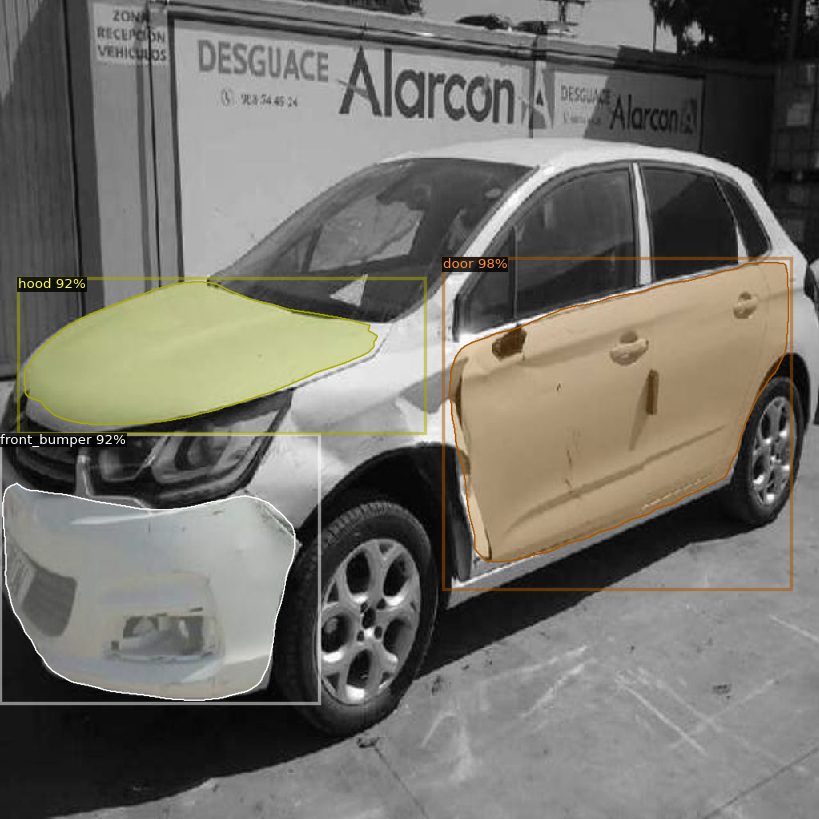

In [ ]:
for d in random.sample(dataset_dicts, 1):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)

    v = Visualizer(im[:, :, ::-1],
                   metadata=MetadataCatalog.get("Valid"),
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

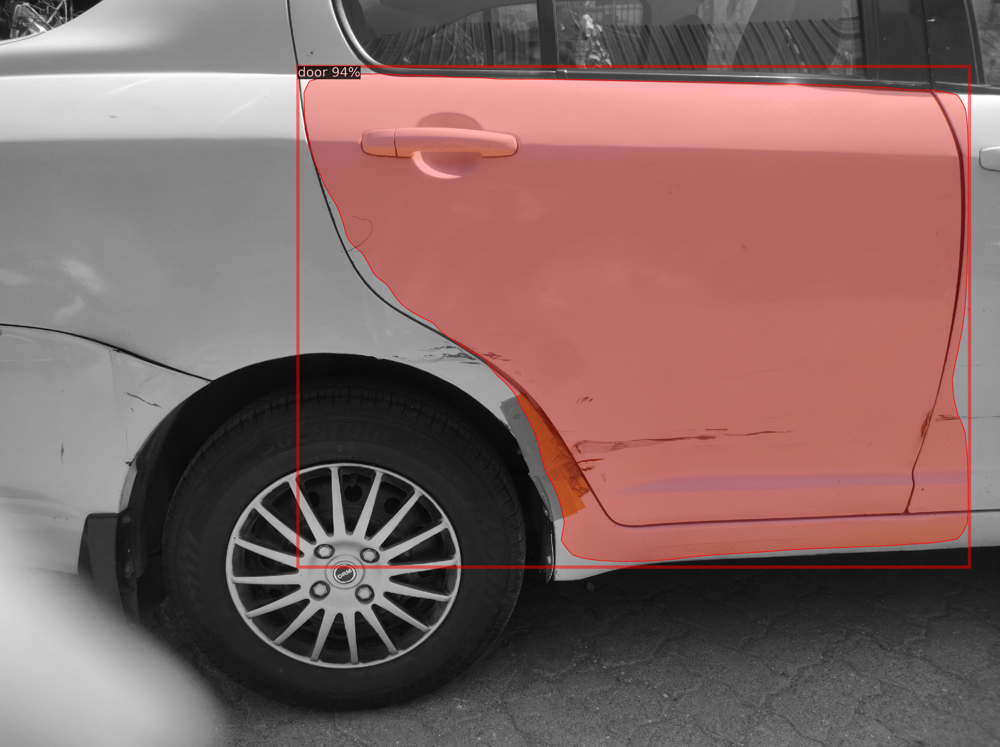

In [ ]:
custom_image_path = "/content/real2_img.jpeg"
im = cv2.imread(custom_image_path)
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
               metadata=MetadataCatalog.get("Valid"),
               scale=0.8,
               instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])
cv2.waitKey(0)
cv2.destroyAllWindows()

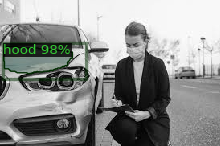

In [ ]:
custom_image_path = "/content/images (1).jpg"
im = cv2.imread(custom_image_path)
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
               metadata=MetadataCatalog.get("Valid"),
               scale=0.8,
               instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
from pycocotools.coco import COCO

In [ ]:
train_annotations_path = os.path.join(train_dir, "COCO_mul_train_annos.json")  # Replace with your actual annotations file
train_coco = COCO(train_annotations_path)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


In [ ]:
for image_id in train_coco.getImgIds():
    image_info = train_coco.loadImgs(image_id)[0]
    image_path = os.path.join(train_dir, image_info['file_name'])

    # Read the image
    im = cv2.imread(image_path)

    # Make predictions
    outputs = predictor(im)

    # Extract predicted boxes, classes, and scores
    predicted_boxes = outputs["instances"].pred_boxes.tensor.cpu().numpy()
    predicted_classes = outputs["instances"].pred_classes.cpu().numpy()
    scores = outputs["instances"].scores.cpu().numpy()

    # Load ground truth annotations for the image
    ann_ids = train_coco.getAnnIds(imgIds=image_id)
    ground_truth_boxes = [train_coco.loadAnns(ann_id)[0]['bbox'] for ann_id in ann_ids]

    # Loop through the predictions
    for box, cls, score in zip(predicted_boxes, predicted_classes, scores):
        # Store the results in the DataFrame
        results_df = results_df.append({
            'image_id': image_info['file_name'],
            'category': cls,
            'predicted_box': box,
            'ground_truth_box': ground_truth_boxes
        }, ignore_index=True)

<ipython-input-67-97c5ae4ca25e>:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
<ipython-input-67-97c5ae4ca25e>:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
<ipython-input-67-97c5ae4ca25e>:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
<ipython-input-67-97c5ae4ca25e>:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
<ipython-input-67-97c5ae4ca25e>:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = 

In [ ]:
results_df.head()

,image_id,category,predicted_box,ground_truth_box
0,10.jpg,2,"[2.9769921, 9.361914, 874.262, 705.3598]","[[3, 3, 879, 677]]"
1,10.jpg,2,"[2.0918458, 0.0, 270.48813, 690.9345]","[[3, 3, 879, 677]]"
2,13.jpg,0,"[705.80774, 308.55066, 978.41864, 842.0562]","[[707, 311, 266, 533], [189, 294, 831, 727]]"
3,13.jpg,1,"[218.19168, 348.78876, 1001.9841, 1024.0]","[[707, 311, 266, 533], [189, 294, 831, 727]]"
4,14.jpg,0,"[410.6761, 34.141502, 771.7149, 558.0092]","[[1, 3, 763, 456], [409, 41, 373, 511], [1, 43..."


In [ ]:
results_df.to_csv('predicted_boxes_with_ground_truth.csv', index=False)

In [ ]:
resultsval_df = pd.DataFrame(columns=['image_id', 'category', 'predicted_box', 'ground_truth_box'])

In [ ]:
valid_annotations_path = os.path.join(val_dir, "COCO_mul_val_annos.json")  # Replace with your actual annotations file
valid_coco = COCO(valid_annotations_path)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [ ]:
for image_id in valid_coco.getImgIds():
    image_info = valid_coco.loadImgs(image_id)[0]
    image_path = os.path.join(val_dir, image_info['file_name'])

    # Read the image
    im = cv2.imread(image_path)

    # Make predictions
    outputs = predictor(im)

    # Extract predicted boxes, classes, and scores
    predicted_boxes = outputs["instances"].pred_boxes.tensor.cpu().numpy()
    predicted_classes = outputs["instances"].pred_classes.cpu().numpy()
    scores = outputs["instances"].scores.cpu().numpy()

    # Load ground truth annotations for the image
    ann_ids = valid_coco.getAnnIds(imgIds=image_id)
    ground_truth_boxes = [valid_coco.loadAnns(ann_id)[0]['bbox'] for ann_id in ann_ids]

    # Loop through the predictions
    for box, cls, score in zip(predicted_boxes, predicted_classes, scores):
        # Store the results in the DataFrame
        resultsval_df = resultsval_df.append({
            'image_id': image_info['file_name'],
            'category': cls,
            'predicted_box': box,
            'ground_truth_box': ground_truth_boxes
        }, ignore_index=True)

<ipython-input-82-9387229c1072>:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  resultsval_df = resultsval_df.append({
<ipython-input-82-9387229c1072>:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  resultsval_df = resultsval_df.append({
<ipython-input-82-9387229c1072>:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  resultsval_df = resultsval_df.append({
<ipython-input-82-9387229c1072>:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  resultsval_df = resultsval_df.append({
<ipython-input-82-9387229c1072>:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat 

In [ ]:
resultsval_df.head()

,image_id,category,predicted_box,ground_truth_box
0,1.jpg,0,"[173.43642, 0.0, 504.86984, 146.59732]","[[185, 4, 321, 139], [4, 0, 692, 823]]"
1,1.jpg,1,"[14.038632, 433.3636, 677.90857, 823.8051]","[[185, 4, 321, 139], [4, 0, 692, 823]]"
2,1.jpg,2,"[673.23663, 18.04082, 740.36884, 533.88416]","[[185, 4, 321, 139], [4, 0, 692, 823]]"
3,1.jpg,1,"[0.0, 68.8831, 602.47095, 712.8734]","[[185, 4, 321, 139], [4, 0, 692, 823]]"
4,22.jpg,2,"[811.5042, 239.94843, 1023.6517, 947.11633]","[[0, 322, 331, 701], [390, 329, 71, 358], [415..."


In [ ]:
resultsval_df.to_csv('predicted_boxes_with_ground_truth_valid.csv', index=False)

In [ ]:
def load_annotations(csv_file_path):
    annotations_df = pd.read_csv(csv_file_path)
    return annotations_df

def calculate_iou(box1, box2):
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2

    x_intersection = max(0, min(x1 + w1, x2 + w2) - max(x1, x2))
    y_intersection = max(0, min(y1 + h1, y2 + h2) - max(y1, y2))

    intersection_area = x_intersection * y_intersection
    union_area = w1 * h1 + w2 * h2 - intersection_area

    iou = intersection_area / union_area
    return iou

def assign_cost_for_damagedpart(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(5000, 10000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(3000, 5000)   # Example repair cost for moderate IoU
    elif iou >= 0.3:
        return np.random.randint(1000, 3000)
    else:
        return np.random.randint(100, 1000)

def assign_cost_for_headlamp(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(3000, 5000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(1500, 3000)   # Example repair cost for moderate IoU
    elif iou >= 0.3:
        return np.random.randint(500, 1500)
    else:
        return np.random.randint(100, 500)

def assign_cost_for_rearbumper(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(4000, 9000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(3500, 4000)   # Example repair cost for moderate IoU
    elif iou >= 0.3:
        return np.random.randint(2000, 3500)
    else:
        return np.random.randint(500, 2000)

def assign_cost_for_door(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(8000, 10000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(5000, 8000)   # Example repair cost for moderate IoU
    elif iou >= 0.5:
        return np.random.randint(3000, 5000)
    else:
        return np.random.randint(1000, 3000)

def assign_cost_for_hood(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(4000, 8000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(3000, 4000)   # Example repair cost for moderate IoU
    elif iou >= 0.3:
        return np.random.randint(1600, 3000)
    else:
        return np.random.randint(500, 1500)

def assign_cost_for_frontbumper(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(5500, 10000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(3000, 5500)   # Example repair cost for moderate IoU
    elif iou >= 0.3:
        return np.random.randint(1500, 3000)
    else:
        return np.random.randint(800, 1500)

def assign_repair_costs(category, iou_scores):
    repair_costs = []
    for iou in iou_scores:
        if category == 0:
            repair_costs.append(assign_cost_for_damagedpart(iou))
        elif category == 1:
            repair_costs.append(assign_cost_for_headlamp(iou))
        elif category == 2:
            repair_costs.append(assign_cost_for_rearbumper(iou))
        elif category == 3:
            repair_costs.append(assign_cost_for_door(iou))
        elif category == 4:
            repair_costs.append(assign_cost_for_hood(iou))
        elif category == 5:
            repair_costs.append(assign_cost_for_frontbumper(iou))
        else:
            # Default repair cost assignment
            repair_costs.append(np.random(500))  # Example repair cost for unknown category
    return repair_costs

def create_repair_cost_dataset(data):
    repair_dataset = []

    for _, annotation in data.iterrows():
        image_name = annotation['image_id']
        category_id = annotation['category']
        predicted_box = eval(annotation['predicted_box'])  # Assuming the predicted_box is a string representation of a list
        ground_truth_box = eval(annotation['ground_truth_box'])  # Assuming the ground_truth_box is a string representation of a list

        # Calculate IoU using the predicted bounding box
        iou_score = calculate_iou(predicted_box, ground_truth_box[0])  # Use the first ground truth box for simplicity

        # Manually assign repair cost based on category
        repair_cost = assign_repair_costs(category_id, [iou_score])[0]

        # Add information to repair dataset
        repair_dataset.append({
            'image_name': image_name,
            'category_id': category_id,
            'predicted_box': predicted_box,
            'ground_truth_box': ground_truth_box,
            'iou_score': iou_score,
            'repair_cost': repair_cost
        })

    return repair_dataset

def preprocess_data(dataset):
    scaler = StandardScaler()
    bounding_boxes = np.array([data['predicted_box'] for data in dataset])
    standardized_boxes = scaler.fit_transform(bounding_boxes)

    for i, data in enumerate(dataset):
        data['predicted_box'] = standardized_boxes[i].tolist()

    return dataset

train_csv_path = '/content/predicted_boxes_with_ground_truth.csv'
test_csv_path = '/content/predicted_boxes_with_ground_truth_valid.csv'

In [ ]:
from sklearn.linear_model import LinearRegression
def train_repair_cost_model(train_data):
    X_train = np.array([data['predicted_box'] for data in train_data])
    y_train = np.array([data['repair_cost'] for data in train_data])

    model = LinearRegression()
    model.fit(X_train, y_train)

    return model

In [ ]:
train_data = load_annotations(train_csv_path)
train_data.head()
train_dataset = create_repair_cost_dataset(train_data)
train_dataset = preprocess_data(train_dataset)
repair_costmodel = train_repair_cost_model(train_dataset)

In [ ]:
repair_cost_model=joblib.load("/content/repair_cost_model.joblib")

In [ ]:
def car_damage_and_repair_cost_estimation(image_path, predictor, model):
    # Load the image
    image = cv2.imread(image_path)

    # Perform prediction using the provided predictor
    output = predictor(image)

    num_instances = len(output["instances"])

    # Print damage status based on the number of instances
    if num_instances > 0:
        damage_status = "Damage Present"
    else:
        damage_status = "No Damage"

    print(f"Damage Status: {damage_status}")

    # Visualize the predictions
    v = Visualizer(image[:, :, ::-1],
                   metadata=MetadataCatalog.get("Valid"),
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(output["instances"].to("cpu"))

    # Extract predicted bounding boxes
    pred_boxes = output["instances"].get("pred_boxes").tensor.cpu().numpy()

    # Perform standardization on bounding boxes
    scaler = StandardScaler()
    standardized_boxes = scaler.fit_transform(pred_boxes)

    # Predict repair cost using the model
    predictions = model.predict(standardized_boxes)

    repair_cost = np.sum(predictions)

    # Return the original image, detected image, and repair cost
    return image, v.get_image()[:, :, ::-1], repair_cost

Damage Status: Damage Present
Original Image:


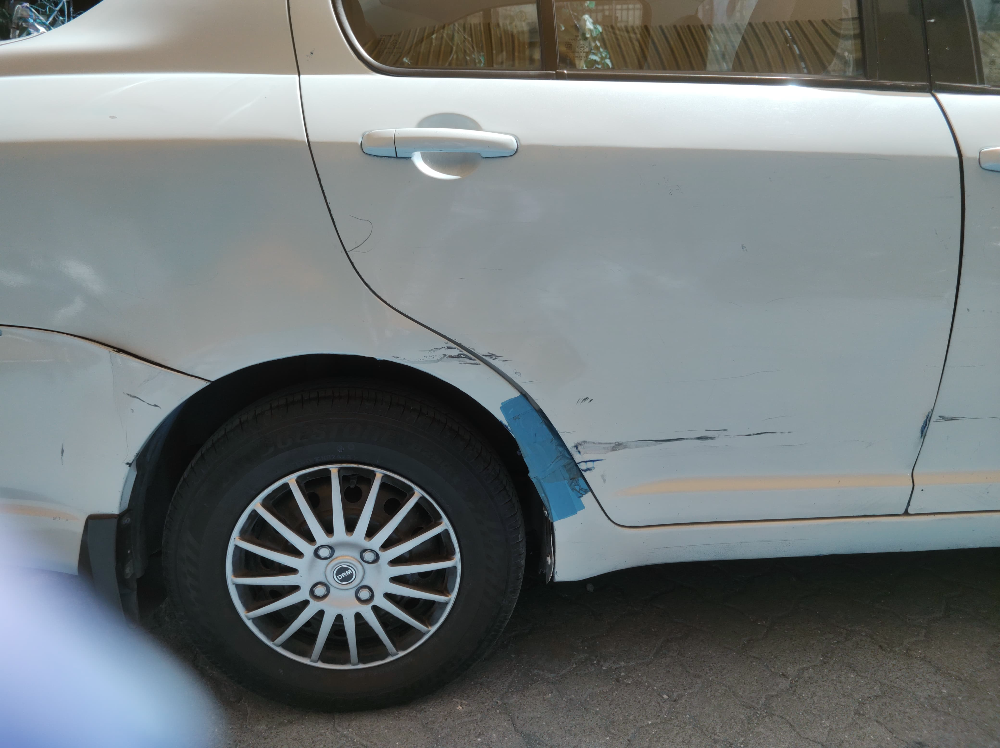

Detected Image:


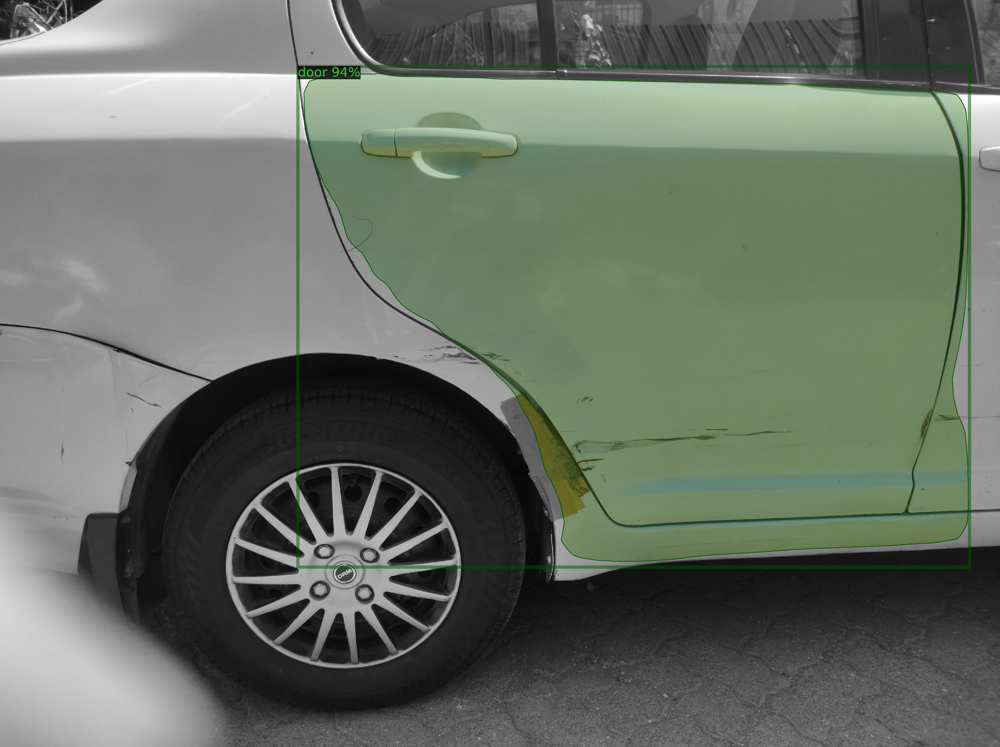

Total Repair Cost: Rs 1569


In [ ]:
# image path
image_path = "//content/real2_img.jpeg"

# Call the function
Original_image, detected_image, repair_cost = car_damage_and_repair_cost_estimation(image_path, predictor, repair_costmodel)

# Display the original image
print("Original Image:")
img=cv2.imread(image_path)
cv2_imshow(img[:, :, ::-1])

# Display the detected image
print("Detected Image:")
cv2_imshow(detected_image)

# Display the repair cost
print(f"Total Repair Cost: Rs {repair_cost:.0f}")

Damage Status: Damage Present


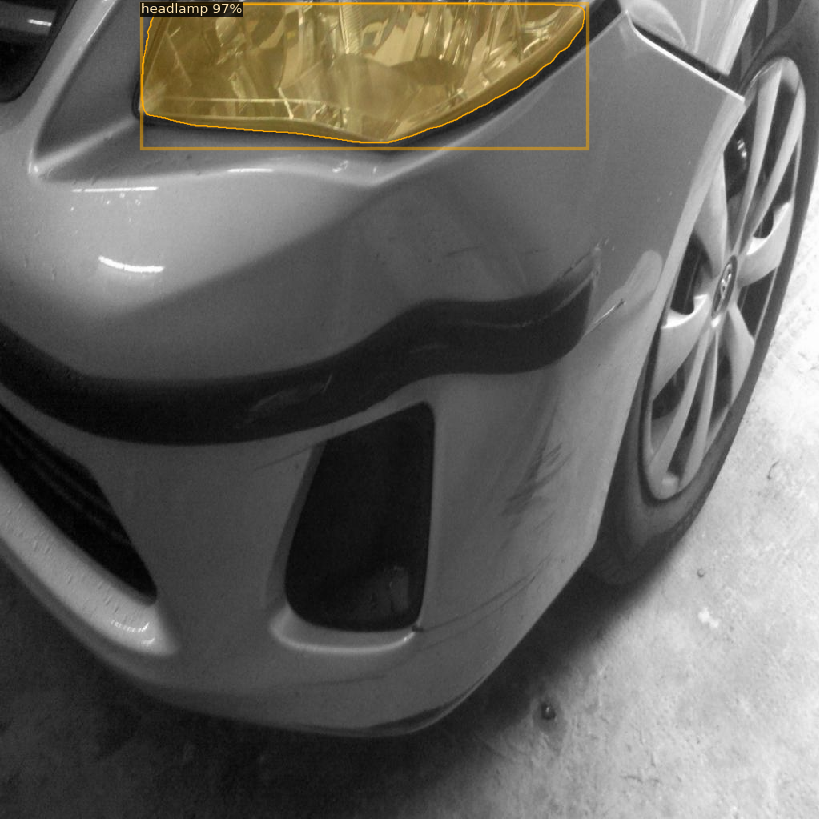

In [ ]:
image = cv2.imread("/content/45.jpg")

    # Perform prediction using the provided predictor
output = predictor(image)

num_instances = len(output["instances"])

    # Print damage status based on the number of instances
if num_instances > 0:
  damage_status = "Damage Present"
else:
  damage_status = "No Damage"

print(f"Damage Status: {damage_status}")

    # Visualize the predictions
v = Visualizer(image[:, :, ::-1],
               metadata=MetadataCatalog.get("Valid"),
              scale=0.8,
              instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
)
v = v.draw_instance_predictions(output["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])